# Object Detection

Object detection is a computer technology related to computer vision and image processing that deals with detecting instances of semantic objects of a certain class (such as humans, buildings, or cars) in digital images and videos. Well-researched domains of object detection include face detection and pedestrian detection. Object detection has applications in many areas of computer vision, including image retrieval and video surveillance. [(Source: Wikipedia)](https://en.wikipedia.org/wiki/Object_detection)

![head_image](images/obj1.jpg)

## Basics of Object Detection

### Image Classification using Convolutional Neural Networks (CNNs)

In deep learning, a convolutional neural network (CNN, or ConvNet) is a class of deep neural networks, most commonly applied to analyzing visual imagery. They are also known as shift invariant or space invariant artificial neural networks (SIANN), based on their shared-weights architecture and translation invariance characteristics. They have applications in image and video recognition, recommender systems, image classification, medical image analysis, natural language processing, and financial time series.

Convolutional Neural Networks have gained a lot of popularity & attention in recent years. They have been employed in many supervised and unsupervised learning problems. Image Classification is the task where we CNN to classify images into different categories. Image Classifications using CNNs is the first step in Object Detection. Example: Train the CNN to classify images of dogs and cats.

![cnn](images/cnn.gif)

### Localization of object in the image

Localization is the part of object detection where a specific object's location is detected in a given image. There are multiple approaches to detect the object in a given image. 

One may ask is the neural network supposed to detect the object in the image by it's own since it performs feature extraction and learns hidden features by its own. 

The answer is **No**. 

![ti](images/ti.gif)

It is because of the primary architecture of the traditional CNN which only focuses on learning the features as they occur in an image and does not care about where it occurs. 

This problem is known as the **Translation Invariance**, where the neural network only cares about the occurence of features and not it's location.

This means that we cannot perform localization to detect where an object occurs in an image.

To overcome this issue, we have 2 commonly used approaches and let us have a look at them.

#### 1. Sliding Window approach

Imagine you move through the image using smaller windows like kernels in Convolutions. You basically move through the image in windows and apply the image classifier to see if it classifies any objects. 

![window](images/window.webp)

This is performed again and again with different window sizes to get set of windows containing the classified objects present in the image. 

![boxes](images/boxes.webp)

This is then visualized by drawing a bounding box for each window of objects. Extra windows can be eliminated by considering the confidence scores.

![sliding_windows](images/sw.webp)

This method has been used in many computer vision techniques like HAAR Cascades, HOG SVMs, etc. But this method is not efficent and is highly computationally expensive.

Image Source & Reference: [Analytics Vidhya](https://www.analyticsvidhya.com/blog/2018/06/understanding-building-object-detection-model-python/)

#### 2. Using Object Coordinates approach

If translation invariance is the problem in object detection using traditional CNNs, why not give the neural network the information about where the object occurs when training set of images so they can predict the object as well its location in any given image?

Yes, it is 100% possible but how do we do that? The answer to this question is we have to annotate our images in the dataset by adding bounding boxes over the objects. Some of the tools that can be used for annotating images for object detection are [OpenLabeling](https://github.com/Cartucho/OpenLabeling), [LabelImg](https://github.com/tzutalin/labelImg), etc.

![label](images/labelling.jpg)

Image source: [labelImg](https://github.com/tzutalin/labelImg)

Once you annotate your images you'll have to train your CNN model with the coordinates using Regression apart from the image classification. You can use any frameworks for this purpose such as Tensorflow Object Detection API, YOLO, Keras, Pytorch/TorchVision, etc.

## Object Detection using Pytorch Torchvision

Let us go ahead create an object detection script using pretrained models available in Torchvision.

### Necessary Imports

In [1]:
import cv2
import torch
import PIL.Image as Image
import matplotlib.pyplot as plt
import IPython.display as display
from torchvision import transforms, models

### Load an image to run the object detection

Let us visualize an image on which we are going to run the object detection model

In [2]:
img_path = 'test_images/7.jpg'

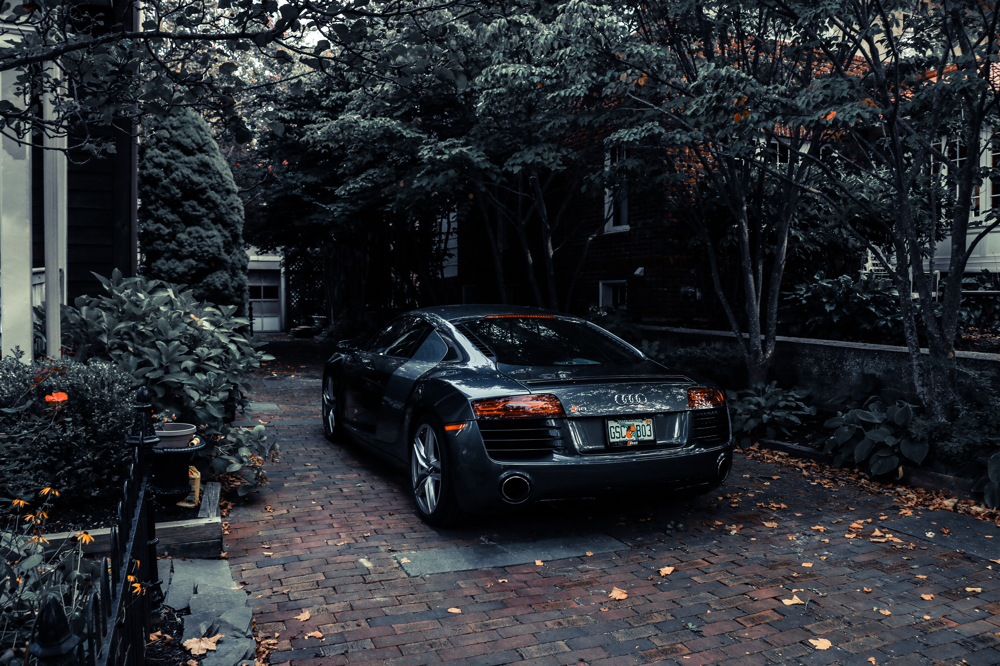

In [3]:
display.display(Image.open(img_path))

### Set Computational Device

Set GPU as device if available or use CPU

In [4]:
device_name = "cuda:0:" if torch.cuda.is_available() else "cpu"
device = torch.device(device_name)

### Convert Image array to a Tensor

Specify a transform object that performs specififed transformations on the image array. Here we convert the image array to a Pytorch tensor.

In [5]:
Transform = transforms.Compose([transforms.ToTensor()])

#### Build the model

Here, we use Faster RCNN pretrained model for object detection.

* Specify the model by using torchvision's model class
* Set model to use a computational device base don availability
* Set the model to evaluation mode

In [6]:
model = models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

model.to(device)

model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform()
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d()
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d()
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d()
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d()
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d()
          )
  

#### Specify Labels

We are using COCO dataset's pretrained weights, so let us use the same labels for prediction. Define LABELS as given in Pytorch's official docs. Some labels are mentioned N/A in the list since few classes were removed in the later papers.

In [7]:
LABELS = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

#### Predict function

* Function accepts two arguments:
    * Image Path
    * Threshold Limit

* Open the image and perform transformation on it

* Perform single forward pass with the model with the image as input

* Get predicted classes, bounding box coordinates, confidence scores, and return only those predictions that cross the threshold limit

In [8]:
def predict(img_path, threshold):
    img = Image.open(img_path)
    img = Transform(img)

    if device_name=="cuda:0:":
        img =img.cuda()

        predictions = model([img])

        pred_label = [LABELS[i] for i in list(predictions[0]['labels'].cpu().numpy())]
        pred_bbox = [[(box[0], box[1]), (box[2], box[3])] for box in list(predictions[0]['boxes'].cpu().detach().numpy())]
        confidence_score = list(predictions[0]['scores'].cpu().detach().numpy())

    else:
        predictions = model([img])

        pred_label = [LABELS[i] for i in list(predictions[0]['labels'].numpy())]
        pred_bbox = [[(box[0], box[1]), (box[2], box[3])] for box in list(predictions[0]['boxes'].detach().numpy())]
        confidence_score = list(predictions[0]['scores'].detach().numpy())

    thresholded = [confidence_score.index(i) for i in confidence_score if i > threshold][-1]

    return pred_bbox[:thresholded+1], pred_label[:thresholded+1], confidence_score[:thresholded+1]   

#### Run Detection function

* Call predict function with image path and threshold as parameters, and store the predictions

* Open the image using CV2

* Append the predicted label, confidence score, and drwa bounding box for all predicted objects using CV2's in-built functions

* Display the image with bounding box, predicted class and confidence score.

In [9]:
def run_detection(img_path, threshold=0.6, box_thickness=3, font_size=3, font_thickness=3):
    bboxes, classes, scores = predict(img_path, threshold)

    img = cv2.imread(img_path, cv2.IMREAD_COLOR)

    for i in range(len(bboxes)):
        text = "Label: {} | Confidence: {:.2f}".format(classes[i], scores[i])
        cv2.rectangle(img, bboxes[i][0], bboxes[i][1], color=(0, 255, 0), thickness=box_thickness)
        cv2.putText(img, text, bboxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, font_size, (0, 255,0), thickness=font_thickness)

    plt.figure(figsize=(20,30))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

#### Run the Detection

Call the Run Detection function for our car image and let us see the results

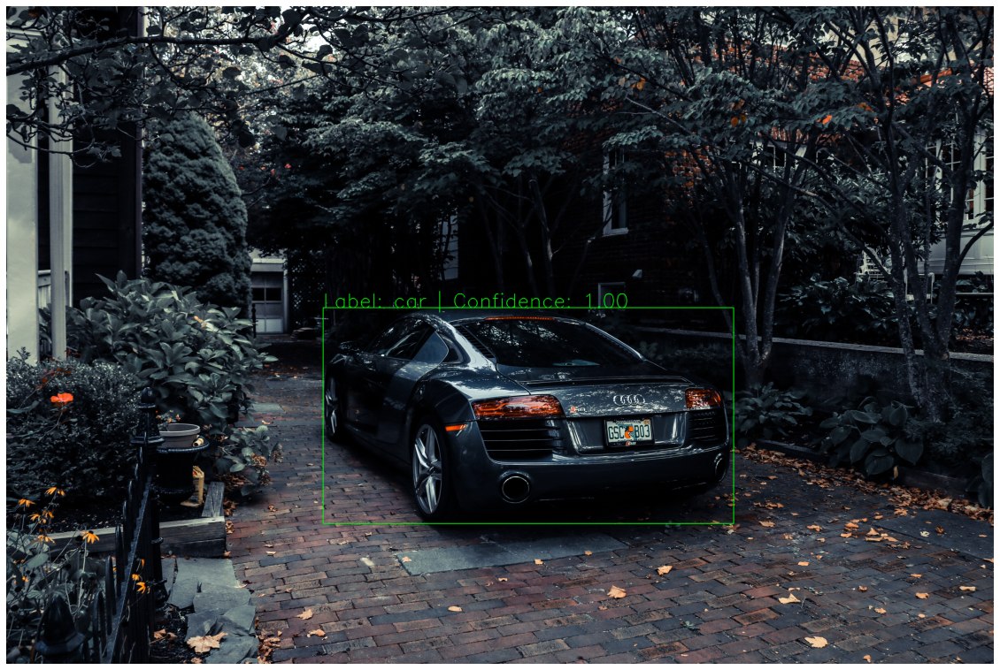

In [10]:
run_detection(img_path, threshold=0.8, font_size=4)

That is pretty impressive. :)

## Test with your own Image

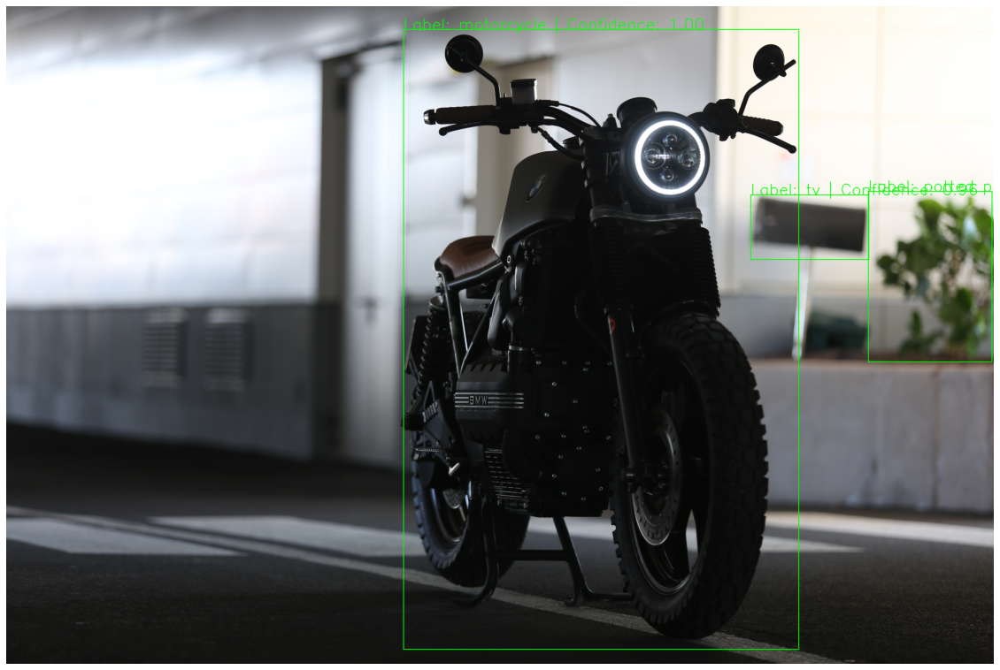

In [11]:
image = input('Enter image path: ')

run_detection(image, threshold=0.8, font_size=3)

### Note

You will find the python script for this tutorial under scripts folder. You'll have to input the image path and threshold. You'll get a new image with detections.

## So What's next?

In the next class, we will see how to train object detection for our own datasets and problem statements. We will also discuss many ways of deploying these models. See you in next class :)